# Make figure 6 of the paper
References: 
- https://www.pygmt.org/v0.2.0/gallery/plot/meca.html

In [2]:
import pandas as pd
import pygmt 
from pyproj import Transformer
import matplotlib.pyplot as plt
from obspy.core.event import read_events

import numpy as np
import matplotlib.colors as mcolors
from matplotlib import cm



In [3]:
df = pd.read_csv('/wd1/hbito_data/data/datasets_all_regions/origin_2010_2015_reloc_cog_ver3_cc.csv',index_col=0)
df


,lat,lon,depth,time,orid,nass,p_picks,s_picks,rms,nsphz,gap,algorithm
0,47.13396,-122.09098,60.1470,1.262305e+09,0,7,2,5,1.081,5.0,243.895048,genie
7,48.17742,-121.83289,6.1630,1.262305e+09,1,55,25,30,0.985,30.0,197.622556,genie
62,47.85353,-122.12435,18.2960,1.262330e+09,2,28,10,18,0.784,18.0,179.587425,genie
90,47.97665,-122.90617,20.9100,1.262336e+09,3,20,10,10,0.465,10.0,153.822127,genie
110,45.86019,-122.19002,8.4035,1.262362e+09,4,39,20,19,0.657,19.0,238.225383,genie
...,...,...,...,...,...,...,...,...,...,...,...,...
1004270,40.59877,-124.40572,20.4825,1.435097e+09,63882,23,9,14,1.015,14.0,77.202555,genie
1004293,40.62611,-127.11445,18.5140,1.435100e+09,63883,12,1,11,0.744,11.0,221.215338,genie
1004305,49.76714,-124.52950,3.6850,1.435101e+09,63884,13,7,6,0.894,6.0,205.239215,genie
1004318,40.66547,-125.33902,3.0525,1.435101e+09,63885,8,3,5,0.982,5.0,141.141631,genie


In [4]:
_df = df[(df.rms < 2.5) & (df.p_picks > 4) & (df.s_picks > 4)].sort_values('nass', ascending=True)
_df

,lat,lon,depth,time,orid,nass,p_picks,s_picks,rms,nsphz,gap,algorithm
1569,40.39755,-124.26059,21.5690,1.262785e+09,92,10,5,5,0.139,5.0,247.951740,genie
3088,40.57964,-124.72002,21.5610,1.263089e+09,188,10,5,5,0.229,5.0,324.598017,genie
3106,40.55800,-124.70344,20.1595,1.263089e+09,190,10,5,5,0.289,5.0,323.850782,genie
3116,40.63660,-124.61038,19.0735,1.263089e+09,191,10,5,5,0.173,5.0,319.877273,genie
3146,40.52416,-124.62841,17.3460,1.263090e+09,194,10,5,5,0.417,5.0,320.769697,genie
...,...,...,...,...,...,...,...,...,...,...,...,...
715957,48.19482,-122.64386,43.7620,1.401017e+09,46632,146,72,74,1.274,74.0,109.305170,genie
332490,43.38426,-127.22685,10.0005,1.340113e+09,22644,147,110,37,1.420,37.0,209.659028,genie
265136,48.74841,-128.26544,45.6345,1.328386e+09,18656,152,102,50,1.296,50.0,199.726879,genie
291140,48.31857,-122.27732,11.9200,1.332624e+09,20177,166,96,70,1.738,70.0,151.820488,genie


## Entire Region

/tmp/ipykernel_34491/4064612463.py:31: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
/tmp/ipykernel_34491/4064612463.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


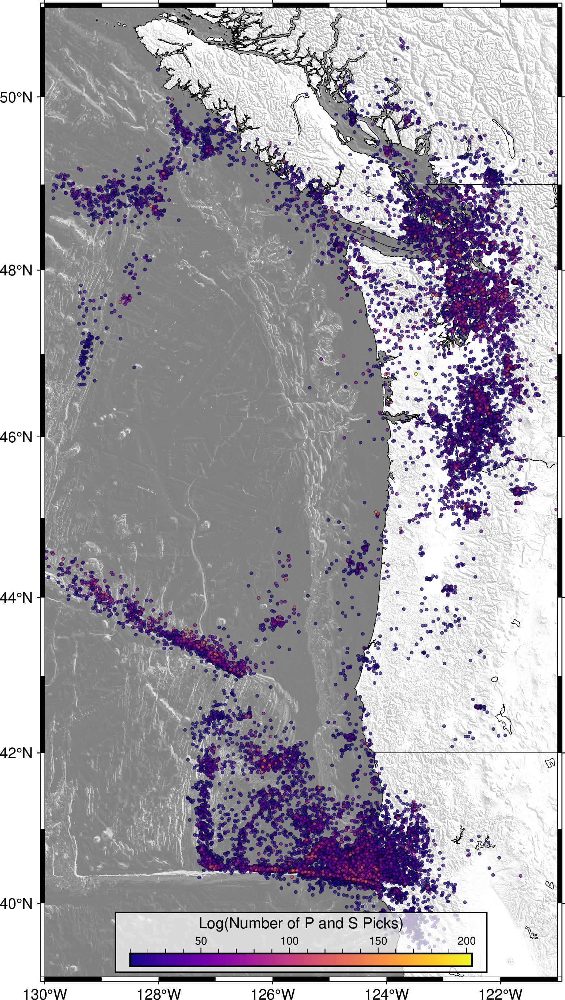

In [ ]:


# # Initialize the figure
# fig = pygmt.Figure()

# # Define target region
# min_lat = 39
# max_lat = 51
# min_lon = -130
# max_lon = -121

# # Define the region to plot
# region = [min_lon, max_lon, min_lat, max_lat]
# title = "(b)"

# # Load grid data
# grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
# shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# # Set up the base map
# fig.basemap(region=region, projection="M12c", frame="af")

# fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
# fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# # Apply logarithmic scale for color mapping
# # Apply log10 transformation to nass values and set color palette
# nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
# nass_log_max = _df['nass'].max() 
# pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# # Plot a dummy point to add the station legend
# fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
# # Plot the stations with the color map applied to the logarithm of "nass"
# fig.plot(
#     x=_df["lon"],
#     y=_df["lat"],
#     style="c0.07c",
#     color=_df["nass"] ,  # Apply log transformation for color mapping
#     cmap=True,
#     pen="0.1p,black",
#     transparency=30
# )

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lLog(Number of P and S Picks)"],
# )
# # Save the figure
# fig.savefig("../data/datasets_all_regions/all_catalog_events_2010_2015_ver3_nass_log.pdf")

# # Display the figure
# fig.show()


## Plot with the focal mechanisms

In [5]:
usgs_cat = read_events('/wd1/hbito_data/data/datasets_all_regions/Cascadia_momenttensors_M5_9.xml')

In [6]:
longitude = []
latitude = []
depth = []
strike = []
dip = []
rake = []
magnitudes = []

for event in usgs_cat:
    try:
        lon = event.origins[1].longitude
        lat = event.origins[1].latitude
        z = event.origins[1].depth / 1000  # Convert depth to km
        for i in range(len(event.focal_mechanisms)):
            if event.focal_mechanisms[i].nodal_planes:
                nodal_plane = event.focal_mechanisms[i].nodal_planes.nodal_plane_1
                continue
            if not event.focal_mechanisms[i].nodal_planes:
                continue
        mag = event.preferred_magnitude()['mag']
        sdr = [nodal_plane.strike, nodal_plane.dip, nodal_plane.rake]
        longitude.append(lon)
        latitude.append(lat)
        depth.append(z)
        strike.append(sdr[0])
        dip.append(sdr[1])
        rake.append(sdr[2])
        magnitudes.append(mag)

    except (IndexError, AttributeError) as e:
        print(f"Skipping event due to missing data: {e}")

df = pd.DataFrame({'lon': longitude, 'lat': latitude, 'strike': strike, 'dip': dip, 'rake': rake,'depth': depth,'mag':magnitudes})


In [7]:
len(usgs_cat)

18

In [8]:
df

,lon,lat,strike,dip,rake,depth,mag
0,-124.6067,40.3180,90.0,80.0,-150.0,17.17,5.72
1,-125.1338,40.8287,200.0,85.0,130.0,16.64,6.80
2,-121.0600,40.1920,105.0,85.0,-140.0,9.70,5.69
3,-128.5420,49.1390,220.0,85.0,5.0,10.00,6.10
4,-127.5370,43.5230,300.0,89.0,-175.0,10.00,5.80
5,-123.7900,41.1430,5.0,40.0,-100.0,28.20,5.60
6,-127.0810,49.3960,350.0,85.0,-165.0,17.30,6.40
7,-127.2400,43.5800,26.0,80.0,-1.0,10.00,5.00
8,-129.3500,49.3300,233.0,42.0,-10.0,10.00,5.30
9,-125.8200,43.7600,19.0,70.0,-17.0,10.00,5.20


In [9]:
df['mag'] = 5.5

In [43]:
# # %matplotlib widget
# lon = []
# lat = []
# strike = []
# dip = []
# rake = []
# magnitude = []
# depth = []
# for c in usgs_cat:
#     lon.append(c.origins[0].longitude)
#     lat.append(c.origins[0].latitude)
    
#     nodalplane = c.focal_mechanisms[1].nodal_planes.nodal_plane_1
#     sdr = [nodalplane.strike,nodalplane.dip,nodalplane.rake]
#     mag = c.preferred_magnitude().mag
#     depth = c.origins[0].depth / 1000.0  # Convert depth from meters to kilometers
#     magnitude.append(mag)
#     strike.append(sdr[0])
#     dip.append(sdr[1])
#     rake.append(sdr[2])

# df = pd.DataFrame({'lon': lon, 'lat': lat, 'strike': strike, 'dip': dip, 'rake': rake, 'mag': mag, 'depth': depth})
# # Plot the data

/tmp/ipykernel_1150063/2033095165.py:31: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
/tmp/ipykernel_1150063/2033095165.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


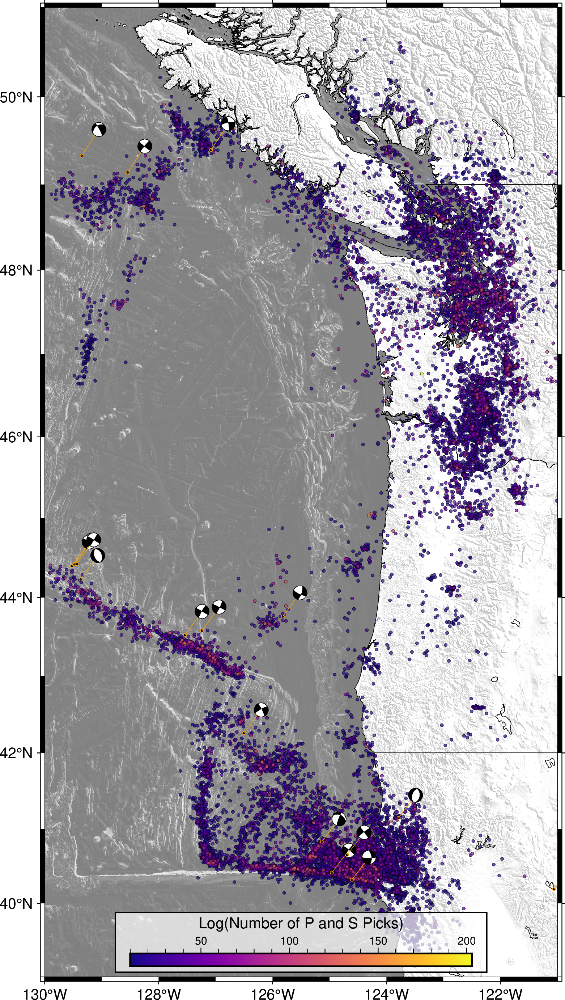

In [10]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 39
max_lat = 51
min_lon = -130
max_lon = -121

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot a dummy point to add the station legend
fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.07c",
    color=_df["nass"] ,  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=30
)

focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,orange+s0.07c")

# Add title text
fig.colorbar(
    position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
    box="+gwhite@30+p0.8p,black",
    frame=["x+lLog(Number of P and S Picks)"],
)
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/all_catalog_events_2010_2015_ver3_cc_nass_fo_m4.png")

# Display the figure
fig.show()


## Axial and Endeavor


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/3753333687.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/3753333687.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


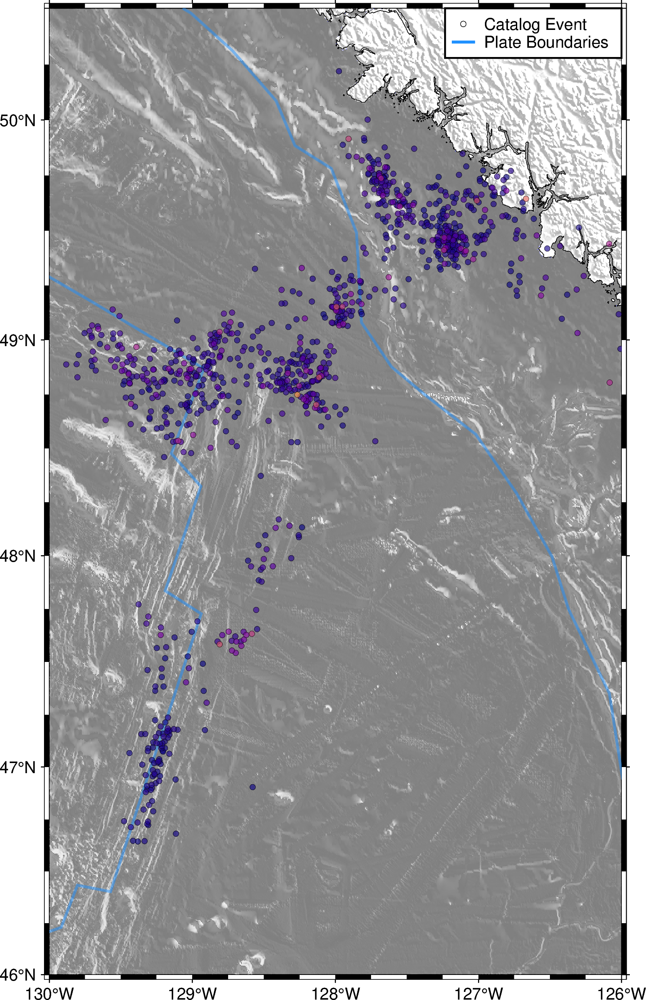

In [11]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50.5
min_lon = -130
max_lon = -126

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(a)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 28),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/axial_endeavor_events_2010_2015_ver3_cc_nass.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/3324994111.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/3324994111.py:45: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


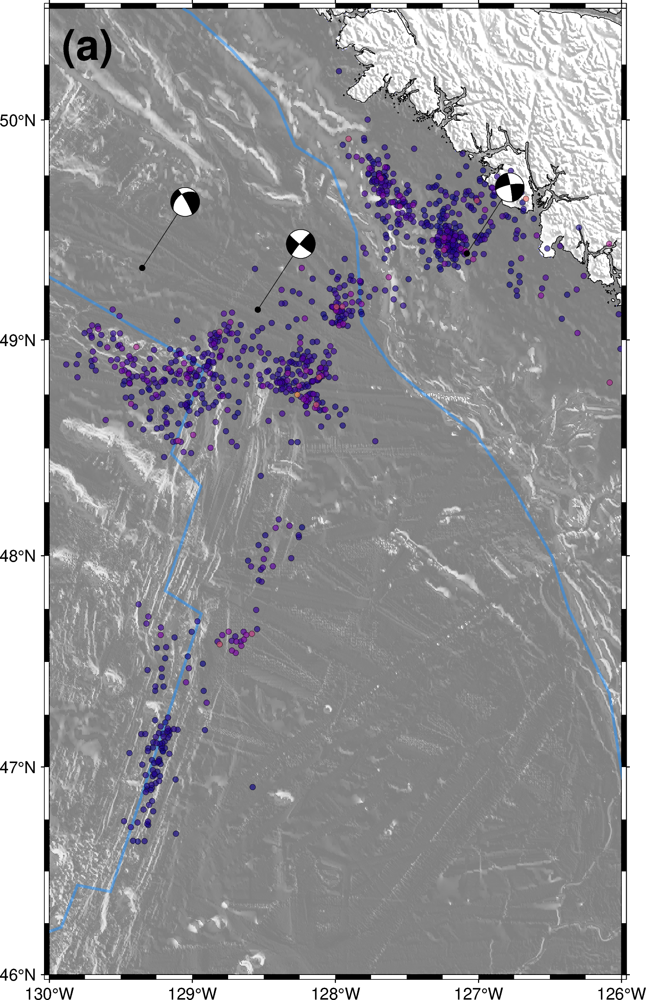

In [12]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50.5
min_lon = -130
max_lon = -126

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(a)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 28),  # Adjust y based on 1.5 cm from top
    text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/axial_endeavor_events_2010_2015_ver3_cc_nass_fo_4_no_legend.png")

# Display the figure
fig.show()


## Mendicino


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/471876684.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/471876684.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


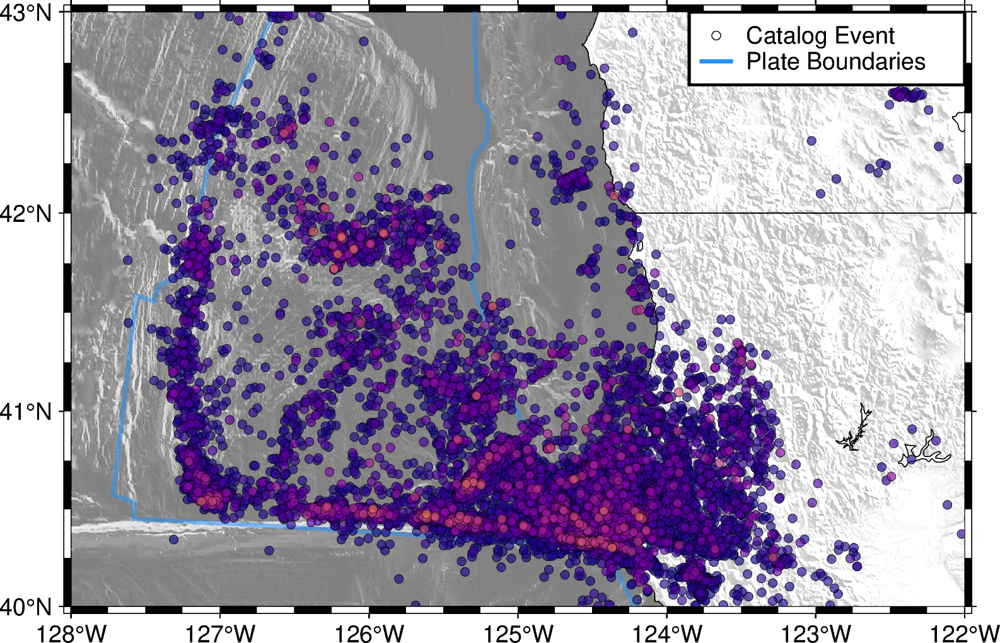

In [14]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 43
min_lon = -128
max_lon = -122

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(b)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 13),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/mendocino_events_2010_2015_ver3_cc_nass_no_relief_no_label.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/3863045566.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/3863045566.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


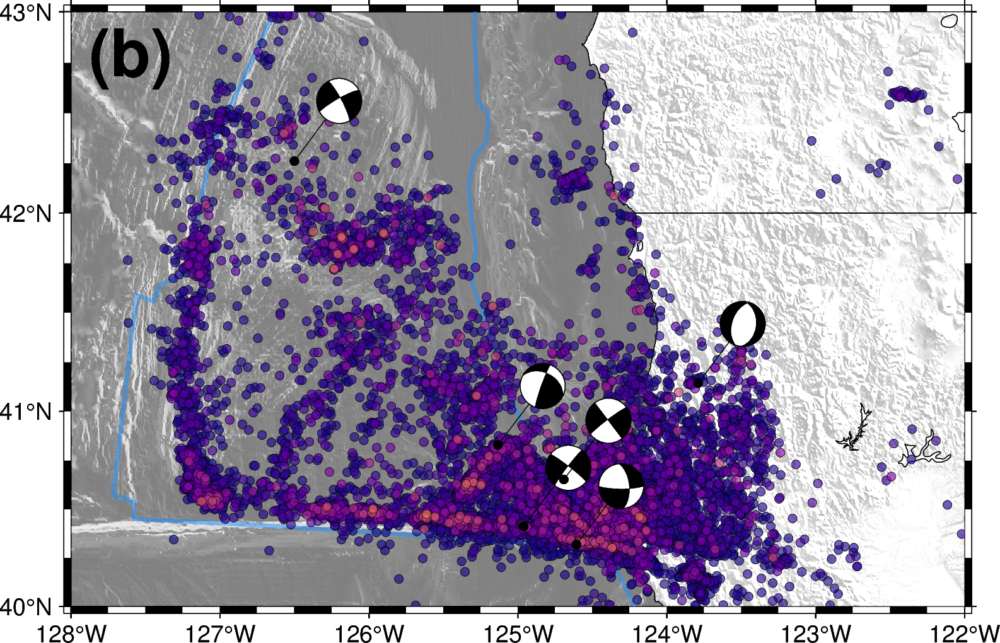

In [15]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 43
min_lon = -128
max_lon = -122

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(b)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 15),  # Adjust y based on 1.5 cm from top
    text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/mendocino_events_2010_2015_ver3_cc_nass_fo_4_no_legend.png")

# Display the figure
fig.show()


## A zoomed-in view of the junction

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/286170088.py:37: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/286170088.py:47: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")
te

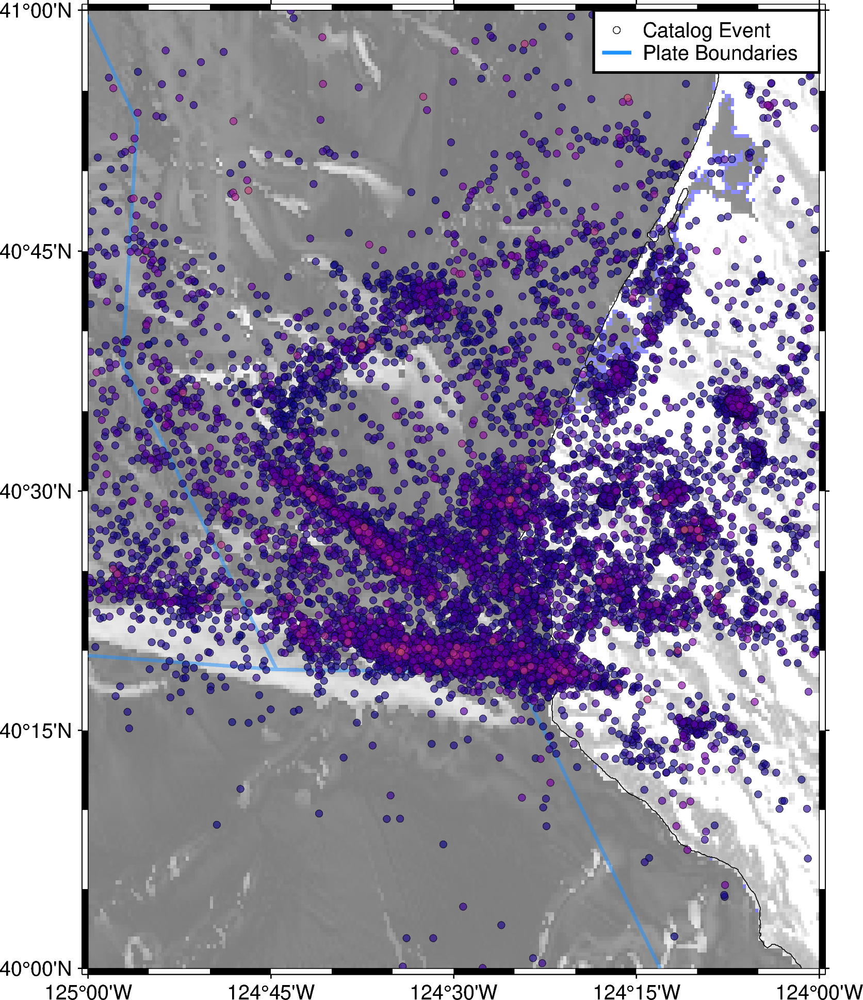

In [17]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 41
min_lon = -125
max_lon = -124


# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = ""

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

fig.text(
    x=-125.25, y=40.36, text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True    # This prevents the text from being clipped
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/mendocino_events_zoomed_in_2010_2015_ver3_cc_nass_no_relief.png")

# Display the figure
fig.show()


## Around 44.5N


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/3470339102.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/3470339102.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


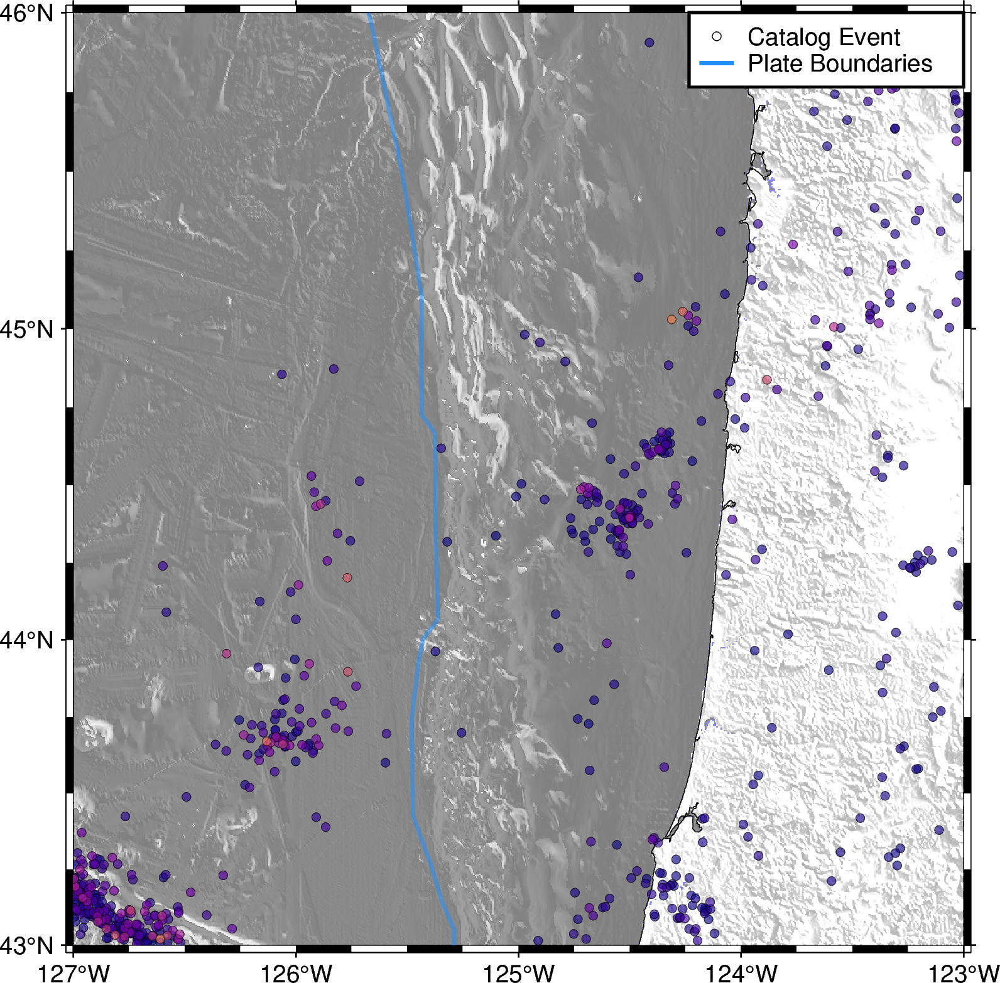

In [18]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 43
max_lat = 46
min_lon = -127
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(c)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 19),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/around_445_events_2010_2015_ver3_cc_nass_no_relief_no_label.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/4144314127.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/4144314127.py:46: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


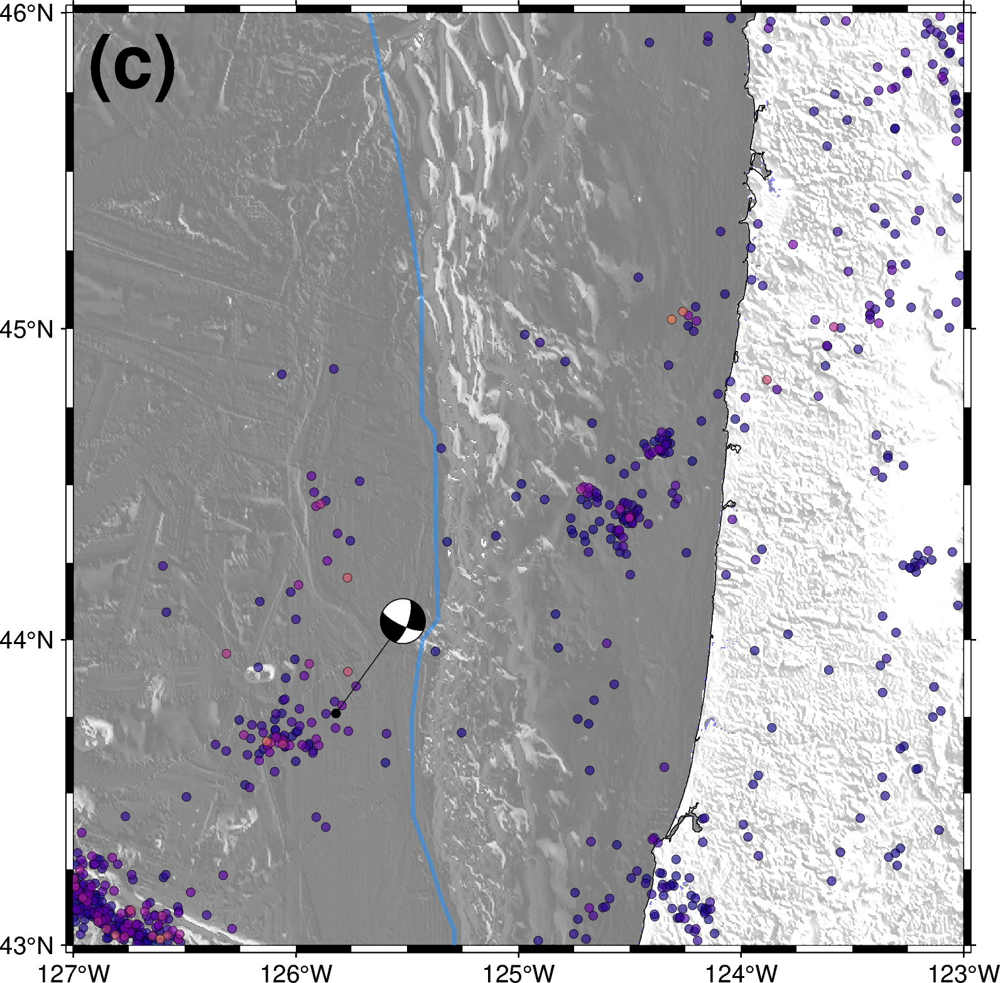

In [19]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 43
max_lat = 46
min_lon = -127
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = "(c)"

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=35
)
# Plot a dummy objects for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
        x=[120, +120],
        y=[-30, -30],
        pen="1.5p,dodgerblue1",label='Plate Boundaries'
    )

# Position the text 1.5 cm from the top left corner
## Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 20),  # Adjust y based on 1.5 cm from top
    text=title,
    font="28p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/around_445_events_2010_2015_ver3_cc_nass_fo_4_no_legend.png")

# Display the figure
fig.show()


## Northern WA

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/187716132.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/187716132.py:44: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


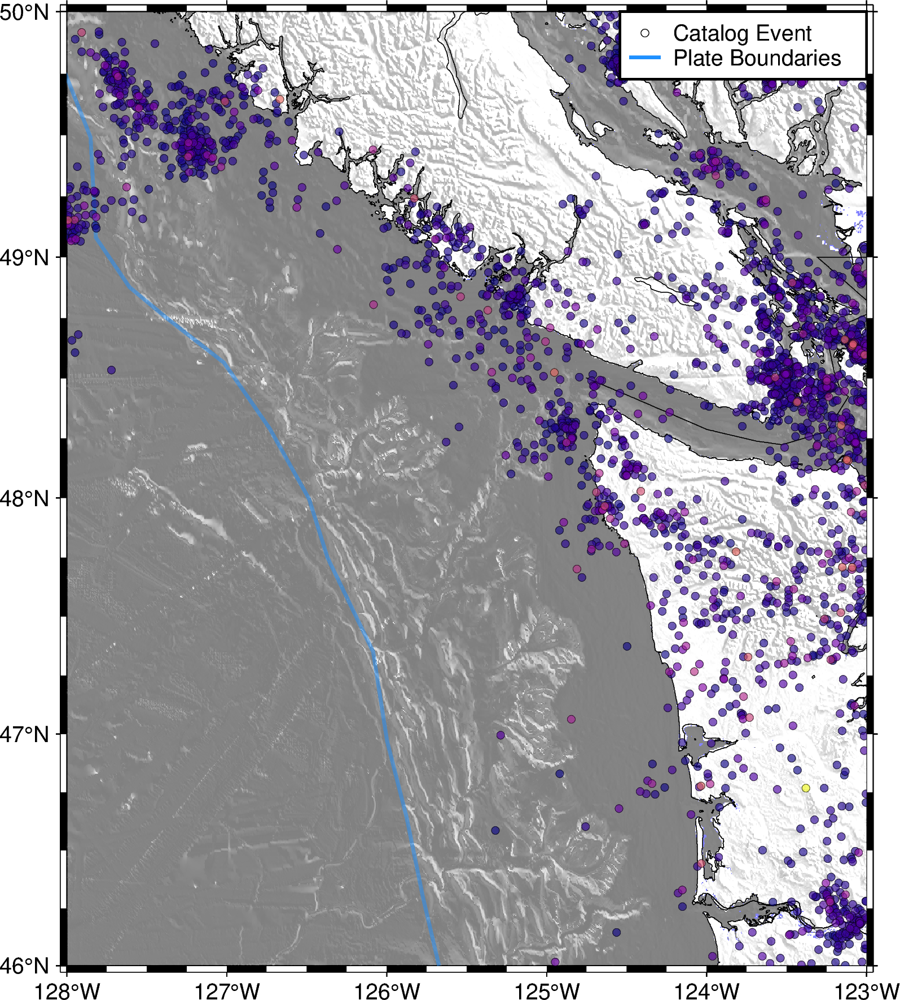

In [20]:
# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50
min_lon = -128
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(d)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
nass_log_min = _df['nass'].min()
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],
    cmap=True,
    pen="0.1p,black",
    transparency=35
)

# Plot a dummy object for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
    x=[120, +120],
    y=[-30, -30],
    pen="1.5p,dodgerblue1", label='Plate Boundaries'
)

# Position the text 1.5 cm from the top left corner
# fig.text(
#     x=min_lon + (max_lon - min_lon) * (1 / 14),  # Adjust x based on 1.5 cm from left
#     y=max_lat - (max_lat - min_lat) * (1 / 21),  # Adjust y based on 1.5 cm from top
#     text=title,
#     font="25p,Helvetica-Bold,black",
#     no_clip=True
# )

# Add the legend to the plot
fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')

# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/northern_wa_events_2010_2015_ver3_cc_nass_no_relief_no_label.png")

# Display the figure
fig.show()

## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file /wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1150063/1752995774.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1150063/1752995774.py:44: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")


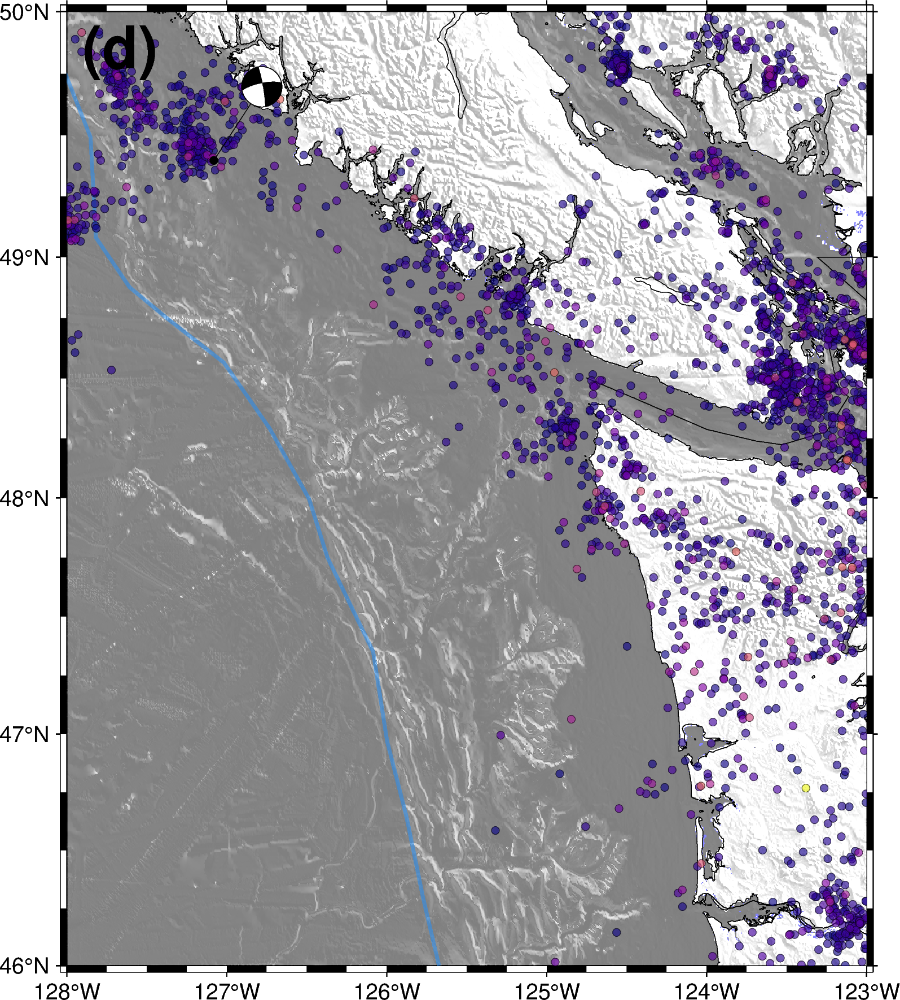

In [21]:
# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50
min_lon = -128
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(d)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="/wd1/hbito_data/data/datasets_all_regions/PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
nass_log_min = _df['nass'].min()
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.12c",
    color=_df["nass"],
    cmap=True,
    pen="0.1p,black",
    transparency=35
)

# Plot a dummy object for the legend
fig.plot(x=[-110], y=[48], style="c0.12c", color="white", label="Catalog Event", pen="0.2p,black")

fig.plot(
    x=[120, +120],
    y=[-30, -30],
    pen="1.5p,dodgerblue1", label='Plate Boundaries'
)

# Position the text 1.5 cm from the top left corner
# Position the text 1.5 cm from the top left corner
fig.text(
    x=min_lon + (max_lon - min_lon) * (1 / 15),  # Adjust x based on 1.5 cm from left
    y=max_lat - (max_lat - min_lat) * (1 / 28),  # Adjust y based on 1.5 cm from top
    text=title,
    font="25p,Helvetica-Bold,black",
    no_clip=True
)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )
focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.55c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball,offset="0.2p,black+s0.12c")
# Add the legend to the plot
# fig.legend(position="JTR+w3.7+jTR", box='+gwhite+p1p')


# Save the figure
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/northern_wa_events_2010_2015_ver3_cc_nass_fo_4_no_legend.png")

# Display the figure
fig.show()

## Plot the colorbar

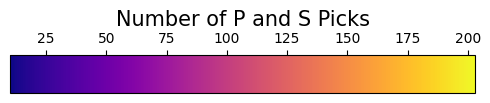

In [22]:
# Define the normalization range and colormap
min_nass = _df['nass'].min()  # Replace with the appropriate data source if needed
max_nass = _df['nass'].max()

norm = mcolors.Normalize(vmin=min_nass, vmax=max_nass)
cmap = cm.plasma  # Use the same colormap as in the previous plots

# Create a figure for the color bar
fig, ax = plt.subplots(figsize=(6, 1))  # Adjust the size as needed
fig.subplots_adjust(bottom=0.5)

# Create the color bar
cbar = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), cax=ax, orientation='horizontal')

# Set the color bar label
cbar.set_label('Number of P and S Picks', fontsize=15)

# Move the ticks and labels above the color bar
cbar.ax.xaxis.set_ticks_position('top')  # Move ticks to the top
cbar.ax.xaxis.set_label_position('top')  # Move the label to the top

# Save the color bar as a PNG
fig.savefig("/wd1/hbito_data/data/datasets_all_regions/colorbar.png", dpi=300, bbox_inches='tight')

# Display the color bar
plt.show()